# Denoising with the deep decoder

The code below demonstrates the denoising performance on an example image.

In [1]:
from __future__ import print_function
import matplotlib.pyplot as plt
#%matplotlib notebook

import os

import warnings
warnings.filterwarnings('ignore')

from include import *
from PIL import Image
import PIL

import numpy as np
import torch
import torch.optim
from torch.autograd import Variable

from pytorch_ssim import pytorch_ssim

GPU = True
if GPU == True:
    torch.backends.cudnn.enabled = True
    torch.backends.cudnn.benchmark = True
    dtype = torch.cuda.FloatTensor
    print("num GPUs",torch.cuda.device_count())
else:
    dtype = torch.FloatTensor


num GPUs 1


### Helper functions for displaying images

In [2]:
def myimgshow(plt, img):
    # Reshape image to channels-last, to fit matplotlib expectation.
    img = img.transpose(1, 2, 0)
    if img.shape[-1] == 1:
        # Remove channels axis for grayscale images.
        img = np.reshape(img, img.shape[:-1])
        plt.imshow(np.clip(img, 0, 1), cmap='gray')
    else:
        plt.imshow(np.clip(img, 0, 1))

def show_results(img_clean_np, img_noisy_np, img_out_np):
    fig = plt.figure(figsize = (15,15)) # create a 5 x 5 figure 

    ax1 = fig.add_subplot(131)
    myimgshow(ax1,img_clean_np) 
    ax1.set_title('Original image')
    ax1.axis('off')

    ax2 = fig.add_subplot(132)
    myimgshow(ax2,img_noisy_np)
    img_clean_var = np_to_var(img_clean_np).type(dtype)
    img_noisy_var = np_to_var(img_noisy_np).type(dtype)
    ax2.set_title("Noisy observation, PSNR: %.2f, SSIM: %.2f" %
                  (psnr(img_clean_np, img_noisy_np), pytorch_ssim.ssim(img_clean_var, img_noisy_var)),
                 fontsize=10)
    ax2.axis('off')
    
    ax3 = fig.add_subplot(133)
    myimgshow(ax3, img_out_np)
    img_out_var = np_to_var(img_out_np).type(dtype)
    ax3.set_title("Deep-Decoder denoised image, PSNR: %.2f, SSIM: %.2f" %
                  (psnr(img_clean_np, img_out_np), pytorch_ssim.ssim(img_clean_var, img_out_var)),
                  fontsize=10) 
    ax3.axis('off')    

    plt.show()

## Load image

This function loads an image from the `test_data` directory, and returns:
  * numpy array of the image's pixel values.
  * a torch.Variable which refers to the numpy array.

Try "phantom256.png" or "astronaut.png".

In [3]:
def load_image(image="astronaut.png", size=None):
    img_path = './test_data/' + image
    img_pil = Image.open(img_path)
    if size is not None:
        img_pil = img_pil.resize((size, size), Image.ANTIALIAS)
    img_np = pil_to_np(img_pil)
    img_clean_var = np_to_var(img_np).type(dtype)
    return img_np, img_clean_var

Image shape: (3, 1024, 1024)
Image shape: (1, 6, 6)


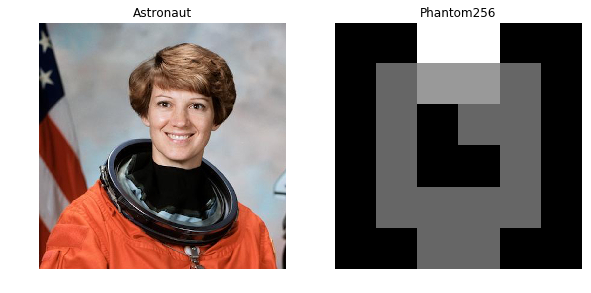

In [4]:
img_np, img_var = load_image("astronaut.png", size=1024)
print("Image shape: %s" % str(img_np.shape))

fig = plt.figure(figsize = (15,15)) # create a 5 x 5 figure 

ax1 = fig.add_subplot(131)
myimgshow(ax1, img_np)
ax1.set_title('Astronaut')
ax1.axis('off')

img_np, img_var = load_image("phantom256.png", size=6)
print("Image shape: %s" % str(img_np.shape))

ax1 = fig.add_subplot(132)
myimgshow(ax1, img_np)
ax1.set_title('Phantom256')
ax1.axis('off')

plt.show()

### Expected output
```
Image shape: (3, 1024, 1024)
Image shape: (1, 12, 12)
```

## Generate noisy image

Takes in a numpy array image and adds noise.

Returns:
 * A numpy array of the noisy image.
 * A torch.Variable of the noisy image.
 * The output depth (as an int) of the image. For RGB images this is 3, for grayscale it's 1.

In [5]:
def generate_noisy_image(orig_img_np, sigma=30, independent_channels=False):
    # Because our image is normalized, sigma must be scaled.
    sigma /= 255

    if independent_channels:
        # Create independent noise in each channel
        noise = np.random.normal(scale=sigma, size=orig_img_np.shape)
    else:
        # Create identical noise in each channel
        noise = np.random.normal(scale=sigma, size=orig_img_np.shape[1:])
        noise = np.array( [noise]*orig_img_np.shape[0] )

    # Add noise to image.
    img_noisy_np = np.clip(orig_img_np + noise , 0, 1).astype(np.float32)
    img_noisy_var = np_to_var(img_noisy_np).type(dtype)

    output_depth = orig_img_np.shape[0] 
    print("Image size: ", orig_img_np.shape)
    
    return img_noisy_np, img_noisy_var, output_depth

Image size:  (3, 512, 512)
Image shape: (3, 512, 512)
Image size:  (1, 256, 256)
Image shape: (1, 256, 256)


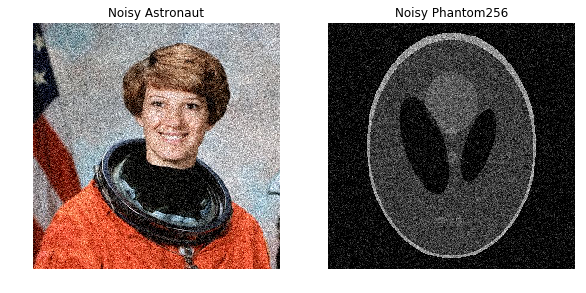

In [6]:
img_np, img_var = load_image("astronaut.png")
img_noisy_np, img_noisy_var, output_depth = generate_noisy_image(img_np, sigma=30)
print("Image shape: %s" % str(img_np.shape))

fig = plt.figure(figsize = (15,15)) # create a 5 x 5 figure 

ax1 = fig.add_subplot(131)
myimgshow(ax1, img_noisy_np)
ax1.set_title('Noisy Astronaut')
ax1.axis('off')

img_np, img_var = load_image("phantom256.png", size=256)
img_noisy_np, img_noisy_var, output_depth = generate_noisy_image(img_np, sigma=1)
print("Image shape: %s" % str(img_noisy_np.shape))

ax1 = fig.add_subplot(132)
myimgshow(ax1, img_noisy_np)
ax1.set_title('Noisy Phantom256')
ax1.axis('off')

plt.show()

## Denoise noisy image

In [7]:
def denoise_image(img_noisy_var,
                  img_clean_var,
                  output_depth,
                  iterations=1000,
                  
                  alpha=0.01,
                  regularization_noise=0.015,
                  opt_input=False,
                  reg_noise_std=0.015,
                  reg_noise_decayevery=100000,
                  mask_var=None,
                  apply_f=None,
                  loss_func=pytorch_ssim.SSIM(window_size=24),
                  mse_loss_weight=2.0,
                  decaylr=False,
                  net_input=None,
                  net_input_gen="downsample",
                  find_best=False,
                  
                  num_channels_up=[128]*5, 
                  filter_size_up=1,
                  need_sigmoid=True, 
                  pad='reflection', 
                  upsample_mode='bilinear', 
                  act_fun=nn.ReLU(),
                  kernel_size=1,
                  bn_before_act = False,
                  bn_affine = True,
                  ):

    net = decodernw(
        num_output_channels = output_depth, 
        num_channels_up = num_channels_up, 
        filter_size_up = filter_size_up,
        need_sigmoid = need_sigmoid, 
        pad = pad, 
        upsample_mode = upsample_mode, 
        act_fun = act_fun,
        kernel_size = kernel_size,
        bn_before_act = bn_before_act,
        bn_affine = bn_affine).type(dtype)
    
    mse_n, mse_t, ni, net = fit(
        net = net,
        img_noisy_var = img_noisy_var,
        num_channels = num_channels_up,
        img_clean_var = img_clean_var,
        num_iter = iterations,
        LR = alpha,
        OPTIMIZER = 'adam',
        opt_input = opt_input,
        reg_noise_std = reg_noise_std,
        reg_noise_decayevery = reg_noise_decayevery,
        mask_var = mask_var,
        apply_f = apply_f,
        loss_func = loss_func,
        mse_loss_weight = mse_loss_weight,
        decaylr = decaylr,
        net_input = net_input,
        net_input_gen = net_input_gen,
        find_best=find_best)
    
    # Get the output from the network.
    
    # Random input.
    new_input = Variable(torch.zeros(ni.shape))
    new_input.data.uniform_()
    img_out_np = net(ni.type(dtype)).data.cpu().numpy()[0]
    #img_out_np = net(new_input.type(dtype)).data.cpu().numpy()[0]
    
    return img_out_np

Image size:  (3, 256, 256)
Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 100
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


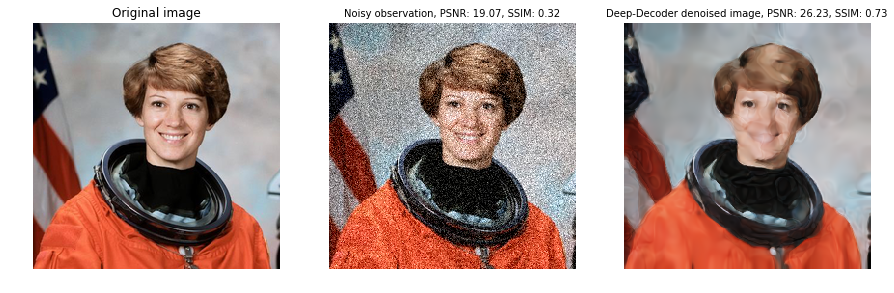

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 40
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


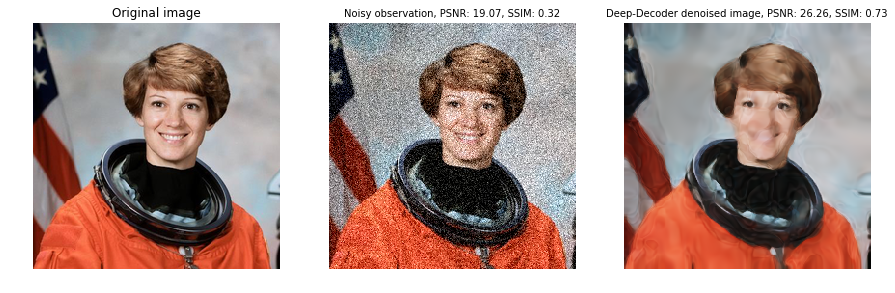

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 11
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


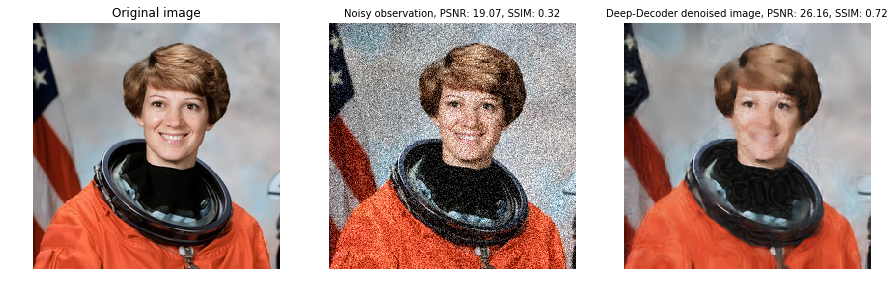

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 3
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


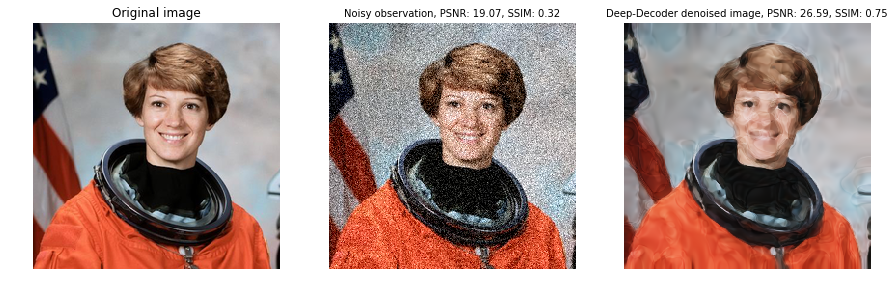

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 2
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


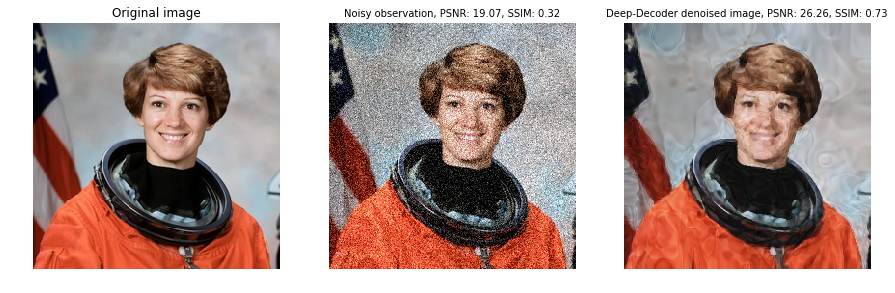

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 100
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



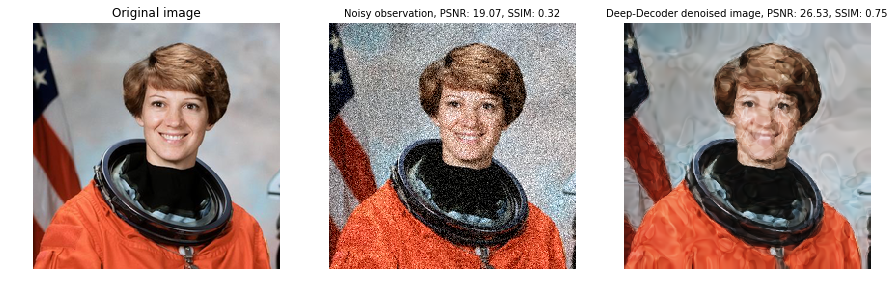

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 100
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


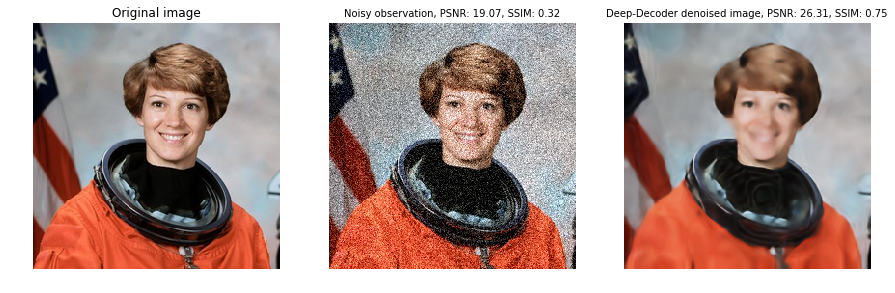

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 40
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


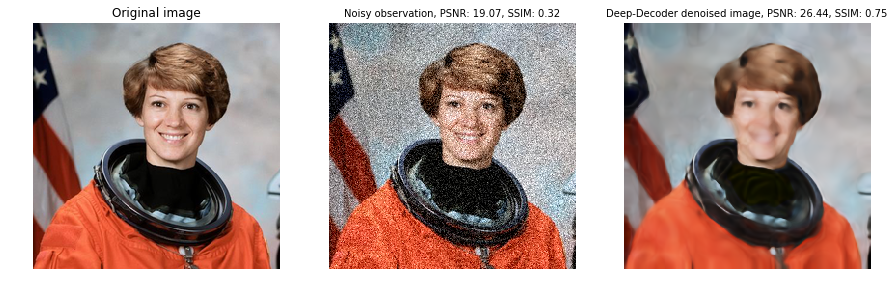

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 11
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


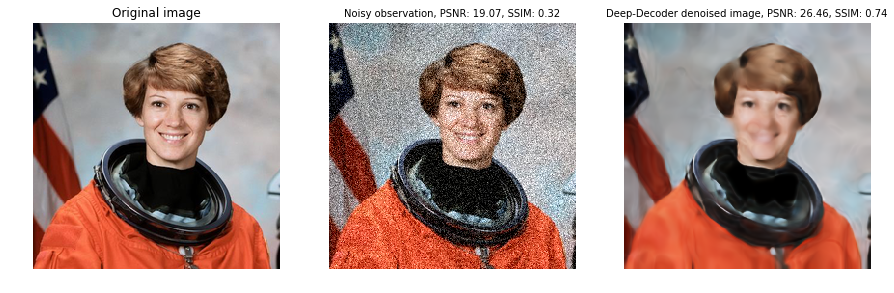

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 3
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


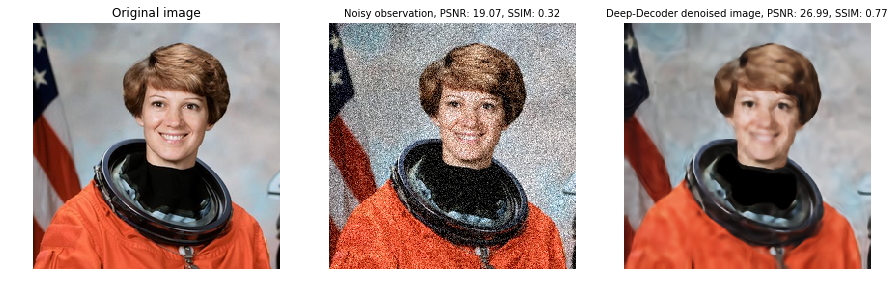

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 2
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


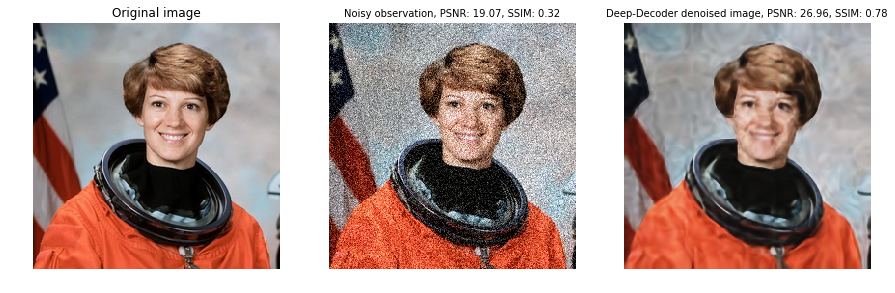

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 100
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



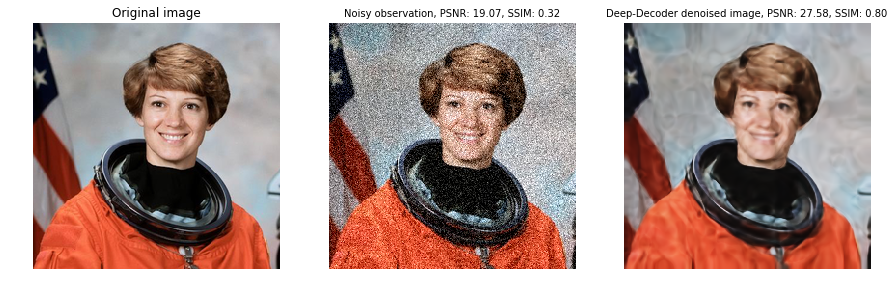

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 2
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


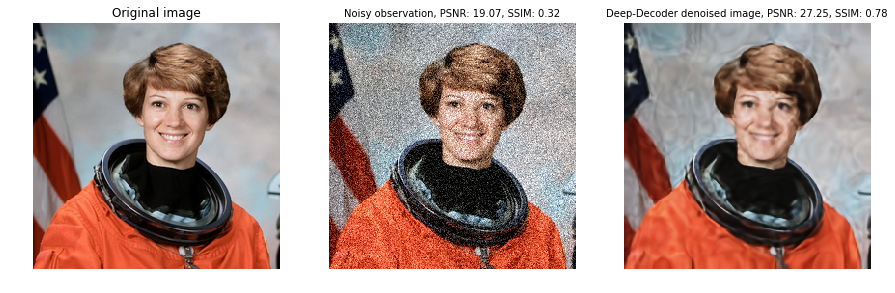

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 100
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


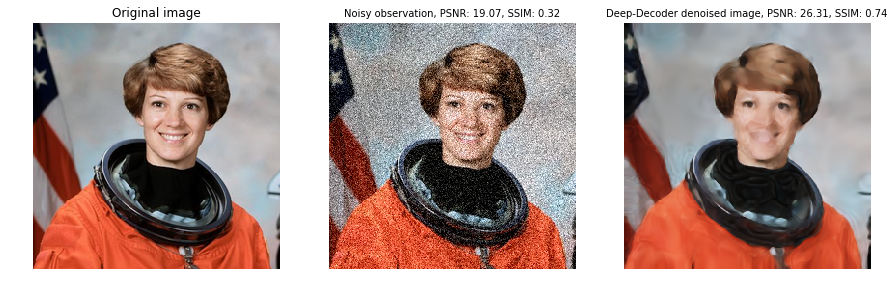

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 40
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


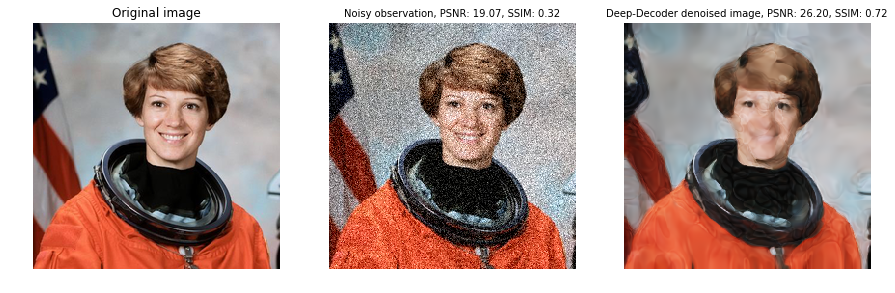

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 11
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


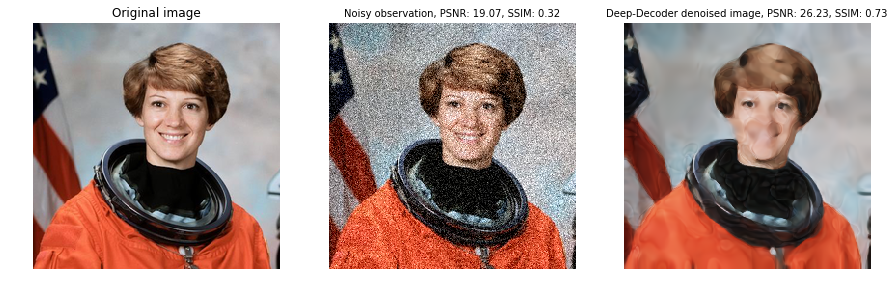

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 3
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


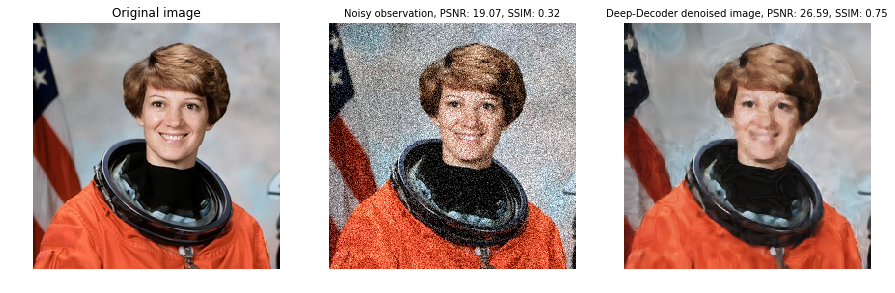

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 2
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



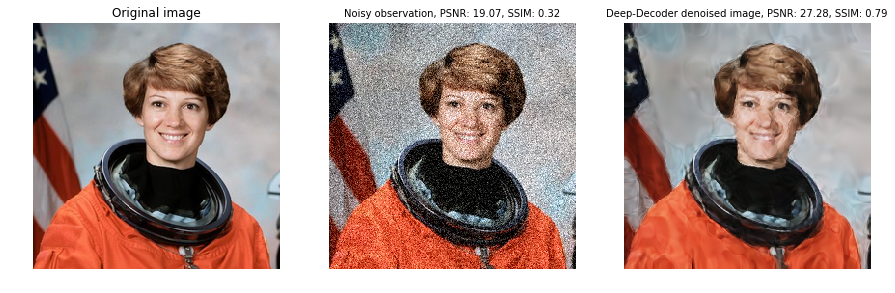

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 11
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


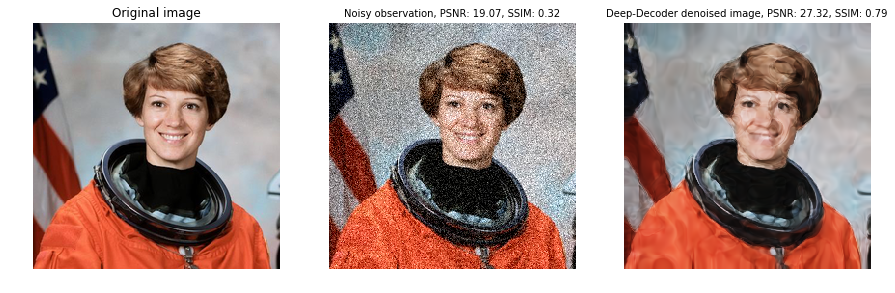

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 3
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


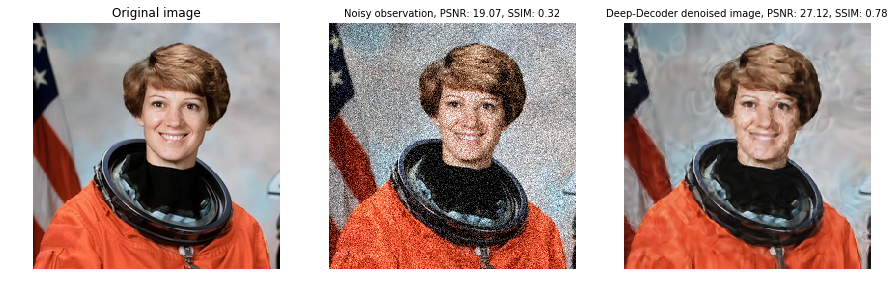

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 2
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


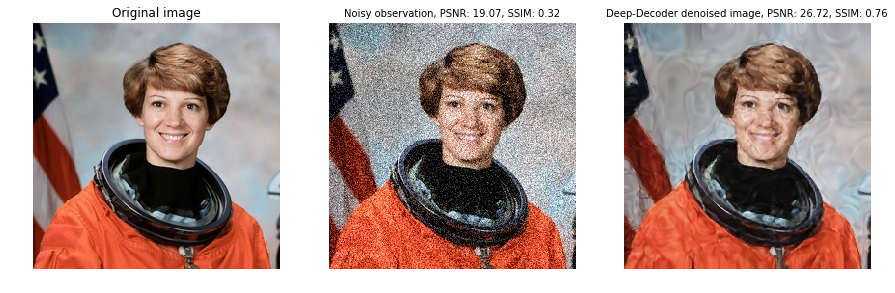

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 100
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


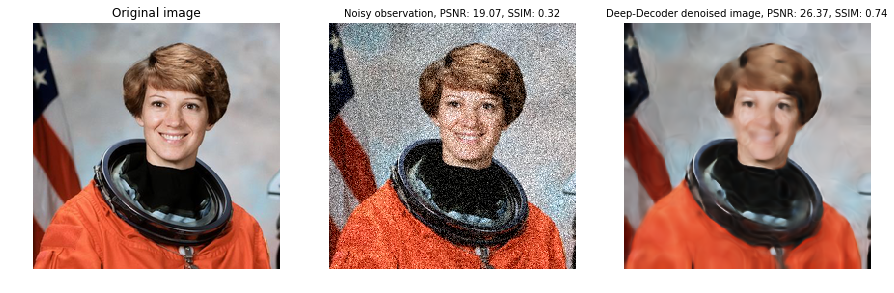

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 40
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


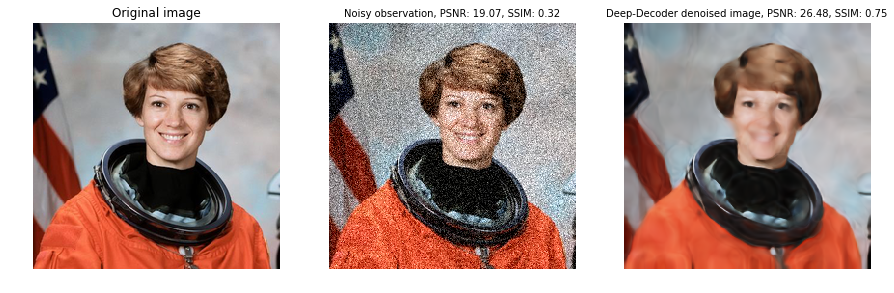

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 11
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



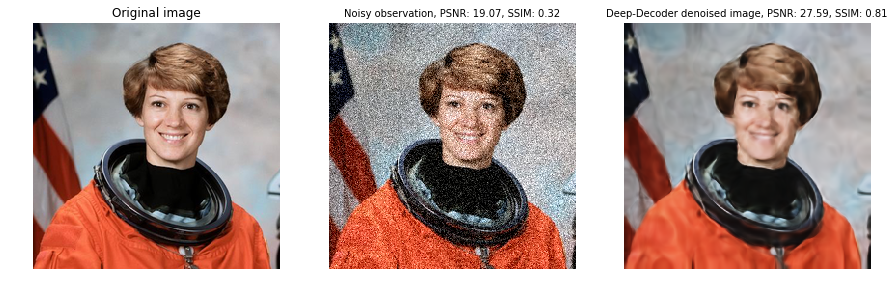

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 40
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


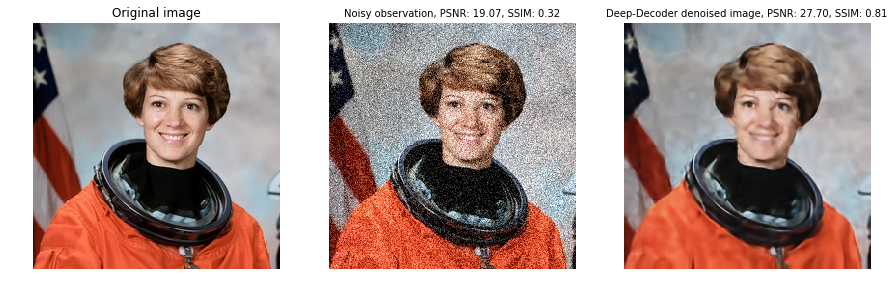

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 11
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


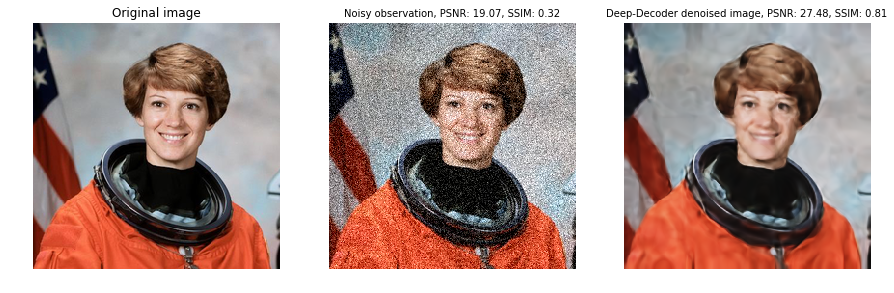

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 3
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


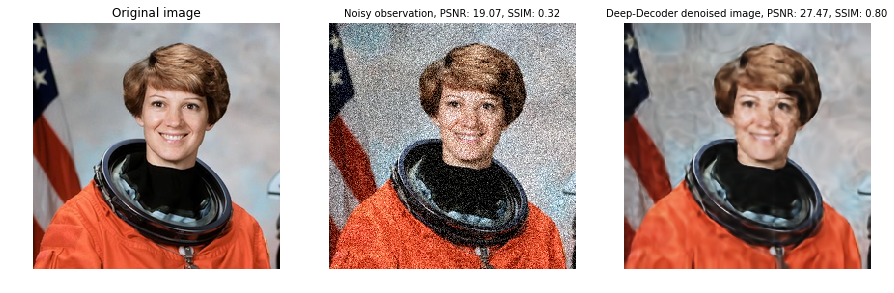

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 2
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


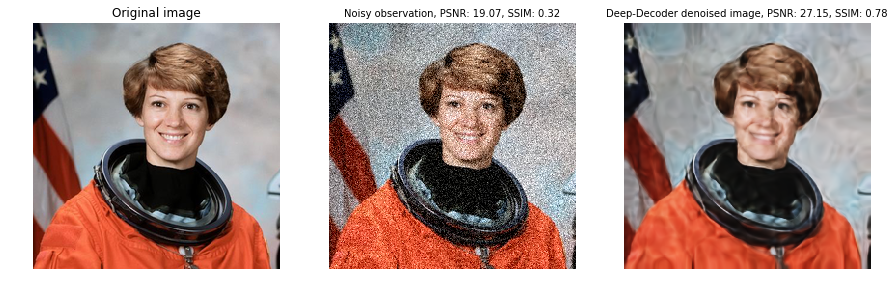

Image size:  (3, 256, 256)
Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 100
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


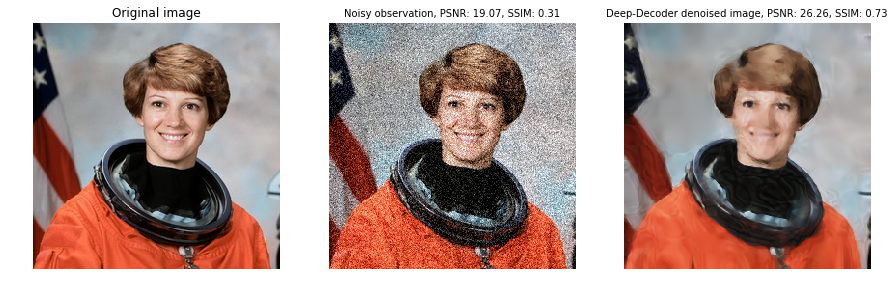

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 40
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



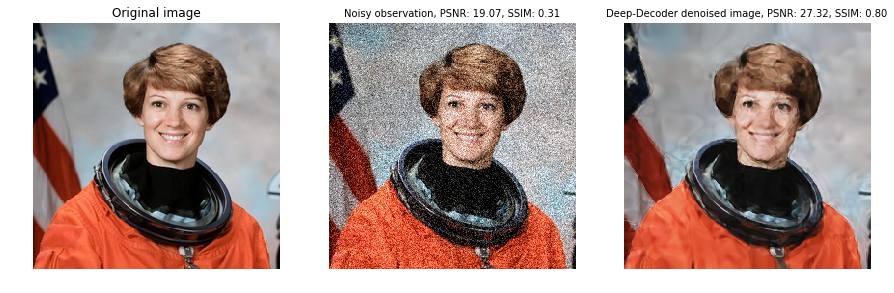

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 40
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


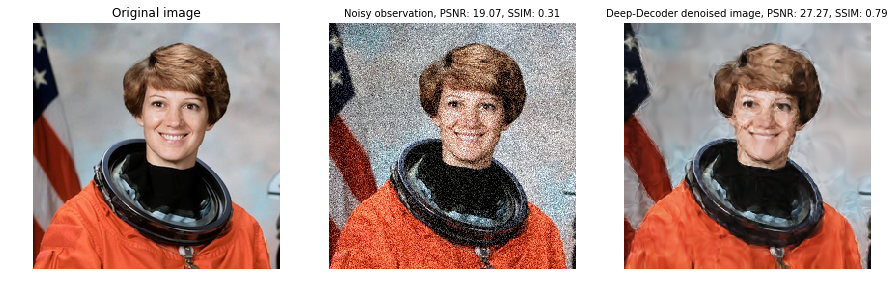

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 11
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


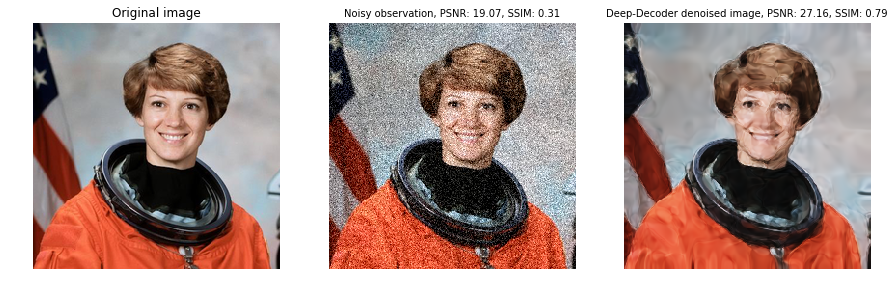

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 3
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


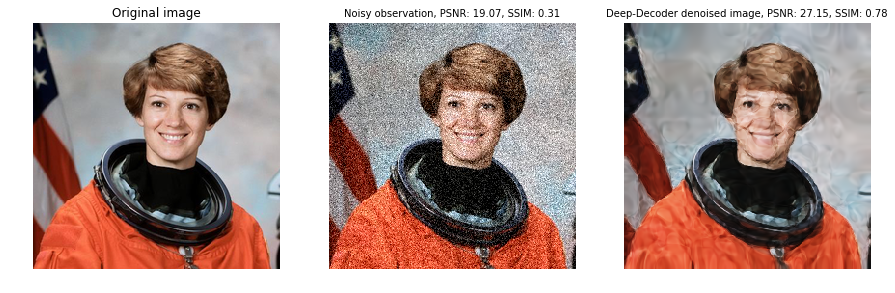

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 2
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


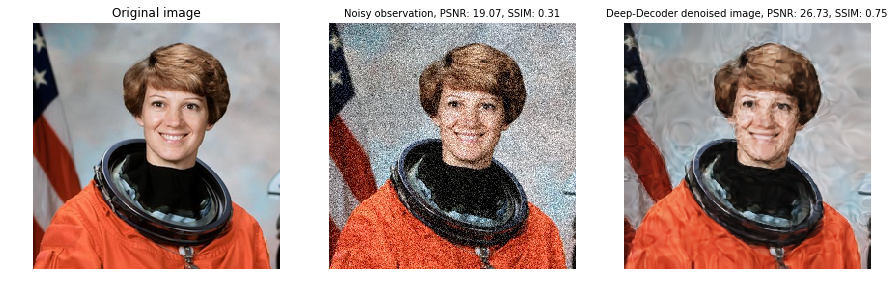

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 100
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



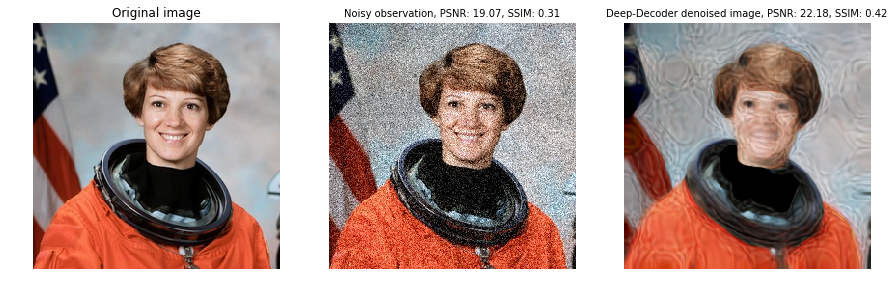

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 40
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


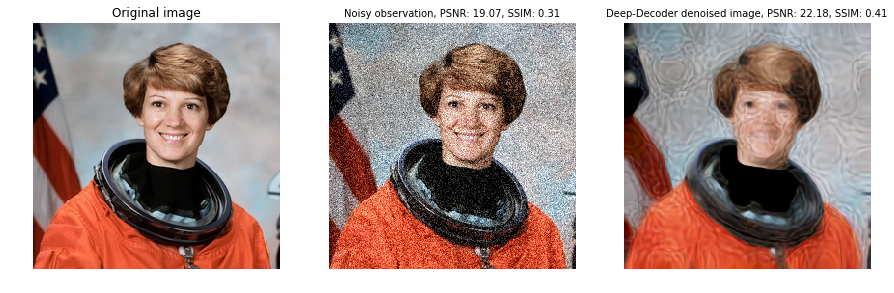

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 11
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


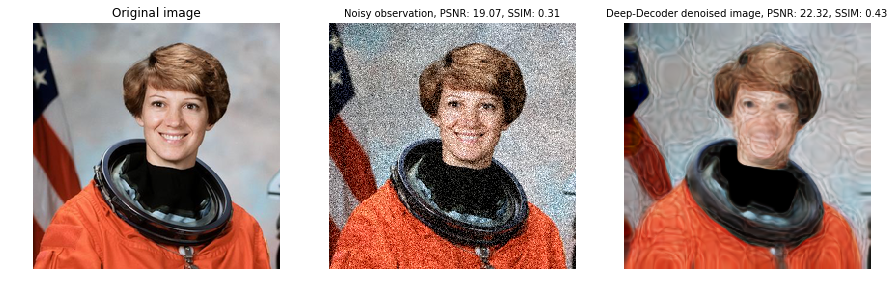

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 3
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


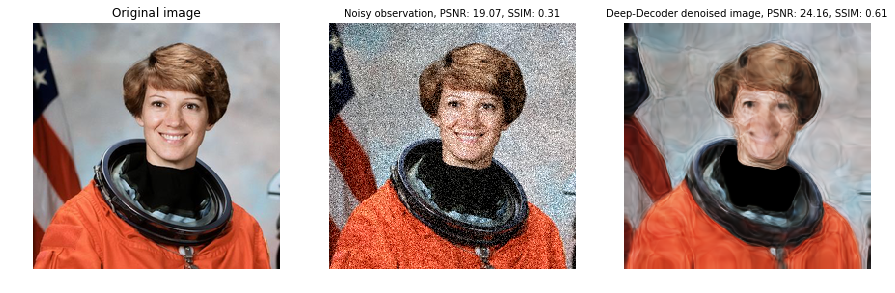

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 2
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


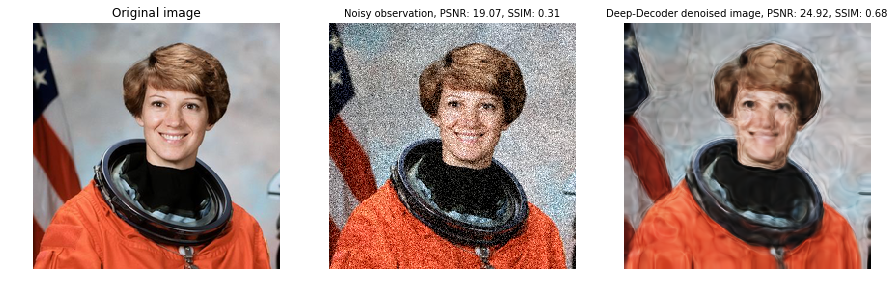

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 100
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


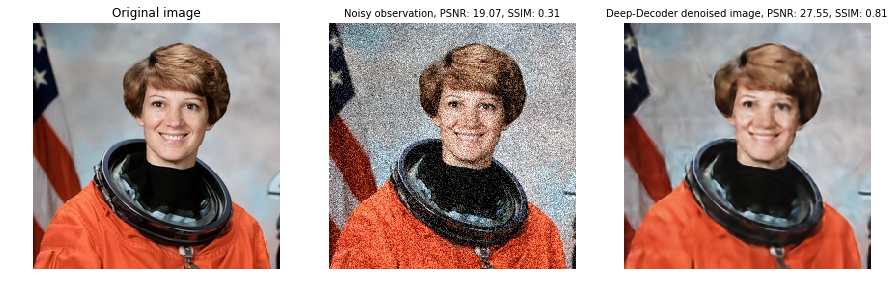

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 40
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


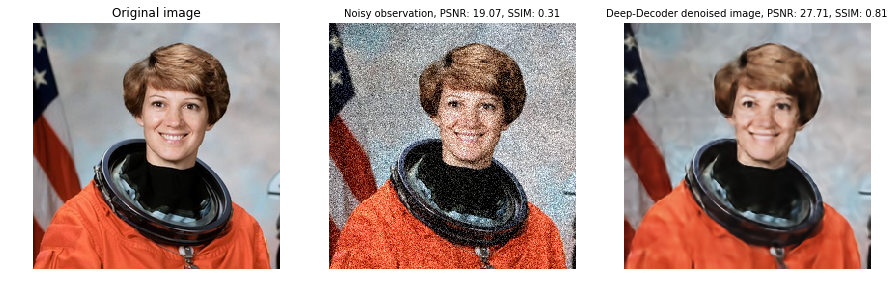

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 11
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


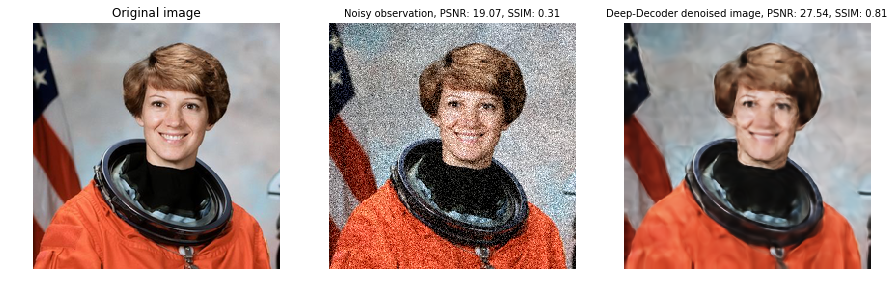

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 3
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


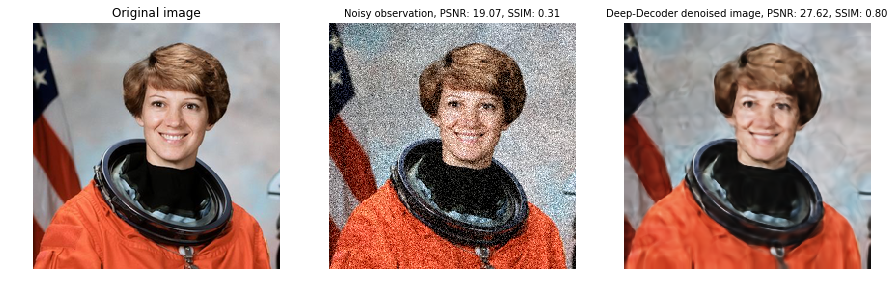

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: random
Reg noise std: 0.015000
activation function: LeakyReLU(negative_slope=0.1, inplace)
SSIM window size: 2
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
optimize with adam 0.01


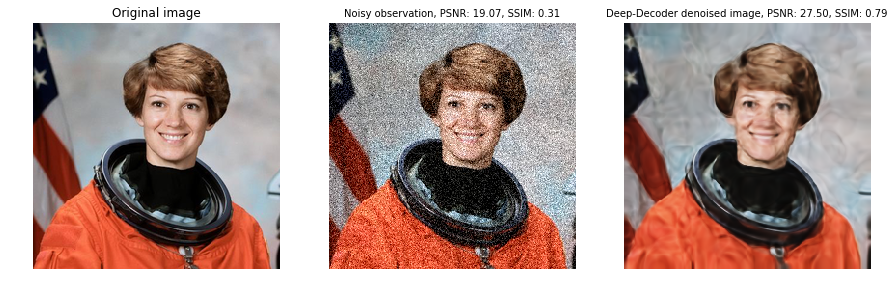

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 100
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


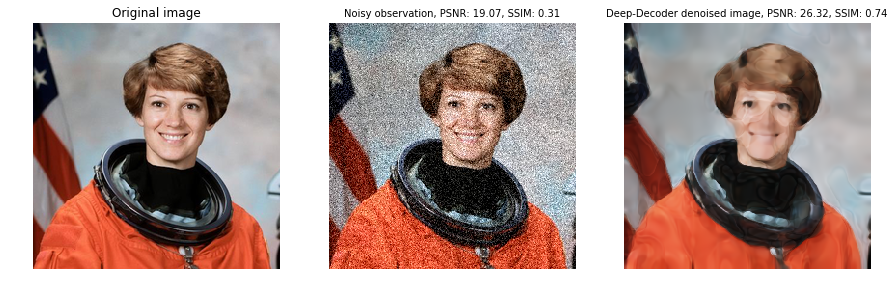

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 40
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


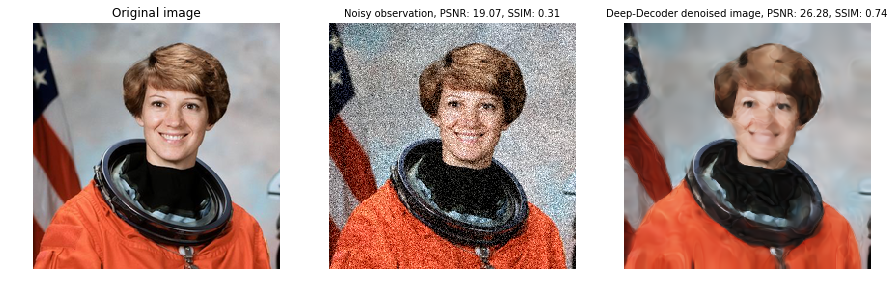

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 11
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


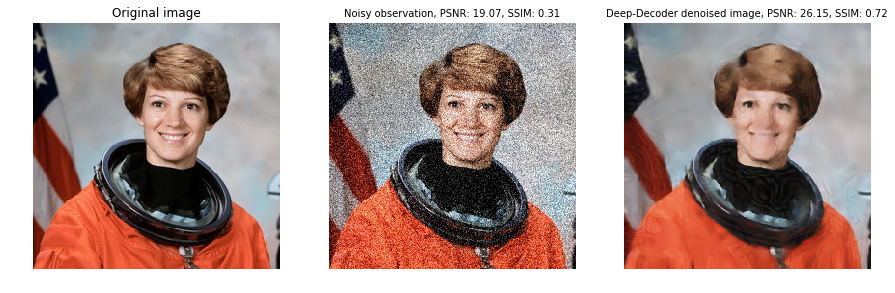

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 3
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


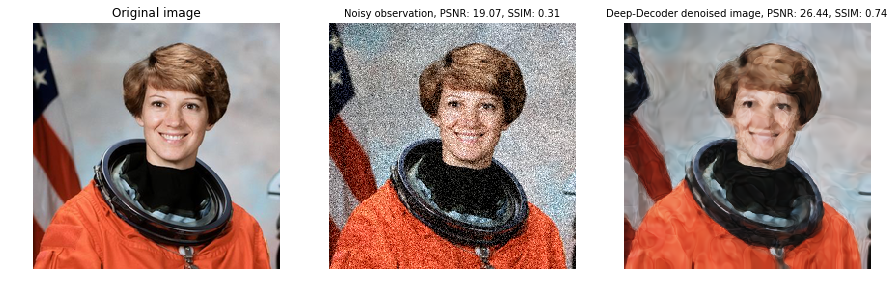

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 2
mse_loss_weight: 40.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


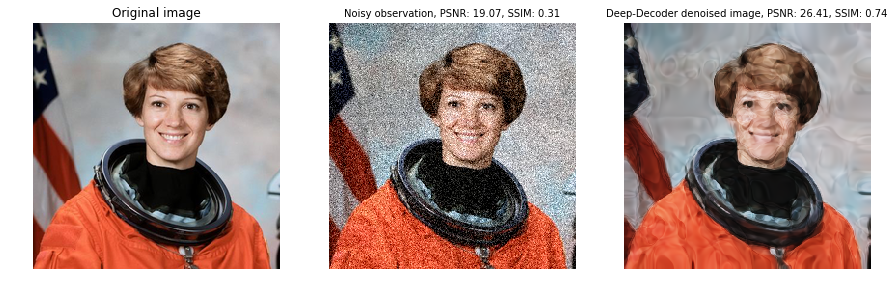

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 100
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


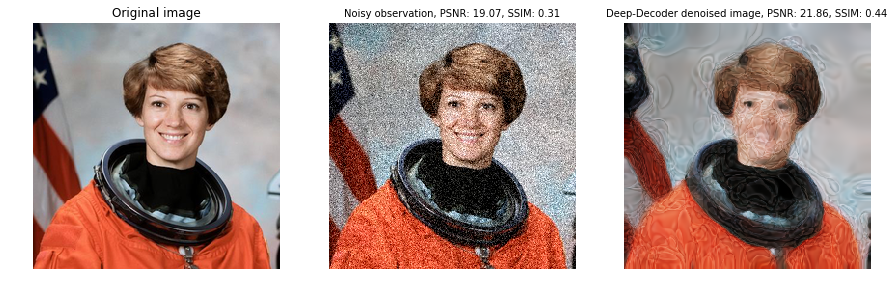

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 40
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


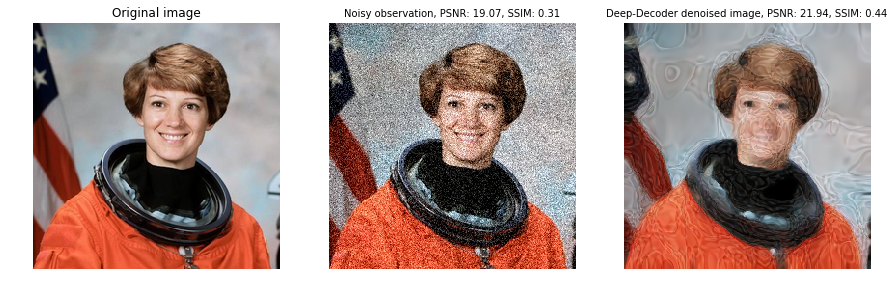

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 11
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


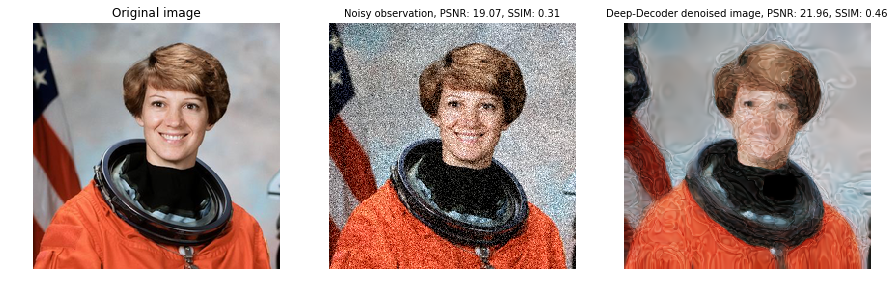

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 3
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


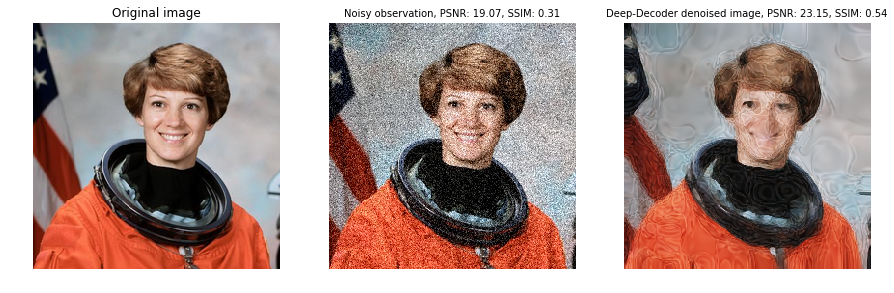

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 2
mse_loss_weight: 20.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


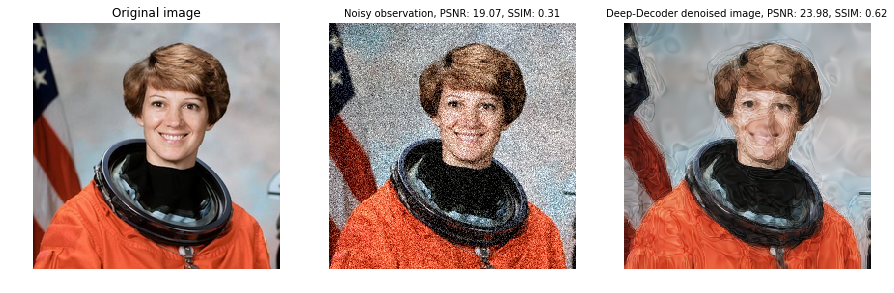

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 100
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


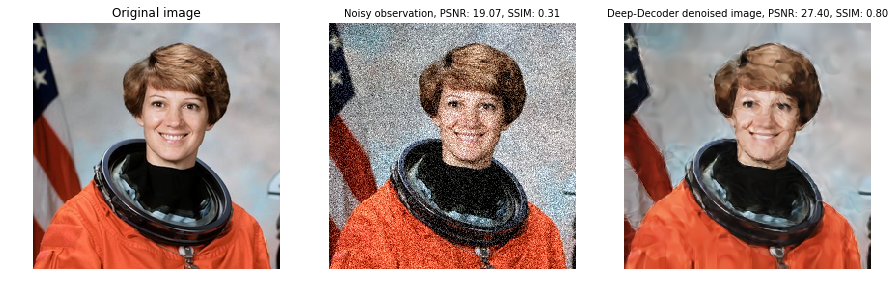

Iterations: 10000
kernel size: 1
Num layers: 5
Input generation mode: downsample
Reg noise std: 0.015000
activation function: Sigmoid()
SSIM window size: 40
mse_loss_weight: 100.000000
network input shape:  [1, 128, 8, 8]
downsampled image shape:  torch.Size([1, 128, 8, 8])
optimize with adam 0.01


In [ ]:
%%timeit -r 1 image = "astronaut.png"

img_clean_np, img_clean_var = load_image(image, size=256)
img_noisy_np, img_noisy_var, output_depth = generate_noisy_image(img_clean_np, sigma=30)
for iterations in [10000]:
    for kernel_size in [1]:
        for num_layers in [5]:
            for num_channels in [128]:
                for net_input_gen in ["random","downsample"]:
                    for reg_noise_std in [0.015]:
                        for act_fun in [nn.Sigmoid(), nn.LeakyReLU(0.1, inplace=True)]:
                            for mse_loss_weight in [40.0, 20.0, 100.0]:
                                for ssim_window_size in [100, 40, 11, 3, 2]:
                                    print("Iterations: %d" % iterations)
                                    print("kernel size: %d" % kernel_size)
                                    print("Num layers: %d" % num_layers)
                                    print("Input generation mode: %s" % net_input_gen)
                                    print("Reg noise std: %f" % reg_noise_std)
                                    print("activation function: %s" % str(act_fun))
                                    print("SSIM window size: %d" % ssim_window_size)
                                    print("mse_loss_weight: %f" % mse_loss_weight)
                                    img_out_np = denoise_image(
                                        img_noisy_var,
                                        img_clean_var,
                                        output_depth,
                                        iterations=iterations,
                                        reg_noise_std=reg_noise_std,
                                        num_channels_up=[num_channels]*num_layers,
                                        filter_size_up=1,
                                        need_sigmoid=True,
                                        pad='reflection',
                                        upsample_mode='bilinear',
                                        net_input_gen=net_input_gen,
                                        act_fun=act_fun,
                                        loss_func=pytorch_ssim.SSIM(window_size=ssim_window_size),
                                        mse_loss_weight=mse_loss_weight,
                                        kernel_size=kernel_size,
                                        bn_before_act=True,
                                        bn_affine=True,
                                        alpha=0.01,
                                        find_best=True)
                                    show_results(img_clean_np, img_noisy_np, img_out_np)

# Experiments

Here we try different network sizes and shapes. The `%%timeit` "magic" commands give us timing information, and the images are output with SNR and SSIM scores and displayed for qualitative comparisons.

In [ ]:
image = "phantom256.png"

img_clean_np, img_clean_var = load_image(image)
img_noisy_np, img_noisy_var, output_depth = generate_noisy_image(img_clean_np, sigma=1)

In [ ]:
%%timeit -r 1 channels=[128]*5

print("With channels: %s" % (str(channels)))
img_out_np = denoise_image(img_noisy_var,
                           img_clean_var,
                           output_depth,
                           num_channels_up=channels,
                           iterations=1000)
show_results(img_clean_np, img_noisy_np, img_out_np)